In [70]:
from functions import *
import matplotlib.pyplot as plt
import numpy as np
from scipy.spatial.distance import cdist
import os

import matplotlib.animation as animation
import time
from matplotlib import gridspec
import matplotlib.patches as mpatches
from matplotlib.lines import Line2D
from matplotlib.patches import Patch
import matplotlib
import matplotlib.cm as cm

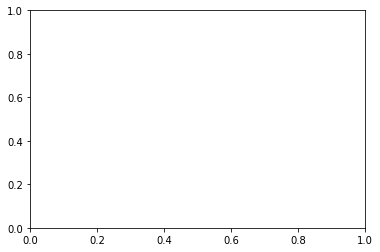

In [9]:

fig = plt.figure()
ax = fig.add_subplot(111)

def animate(t):
    ax.clear()
    for i in range(len(def_loc[:,0])):
        if def_sigma[i]>0:
            ax.scatter(def_loc[i,0]-bias, def_loc[i,1]-bias, marker='+', c='b')
        if def_sigma[i]<0:
            ax.scatter(def_loc[i,0]-bias, def_loc[i,1]-bias, marker='_', c='b')
        ax.plot(X[:t]-bias, Y[:t]-bias)
        ax.set_xlabel('X')
        ax.set_ylabel('Y')
        ax.set_title(str(N)+' +0.5 defects, a='+str(alpha))

In [81]:
L=1e5
l=10
bias = (L-l)/2.0
alpha=+10.0
N=3
a = 0.8*1e-1
def_loc, def_sigma = random_defects(N, l)
# def_loc = np.array([[0.0,0.0], [1.0,1.0], [10.0,10.0], [0.0,10.0]])
def_loc = def_loc+bias
# def_sigma = np.ones(def_sigma.shape)*0.5
tMax = 100
# tMax = get_first_collision((def_loc, def_sigma, L, a, alpha, 0.001, 100))
# print(tMax)
X, Y, Vx, Vy, t = get_trajectory((def_loc, def_sigma, L, a, alpha, tMax, 0.01))

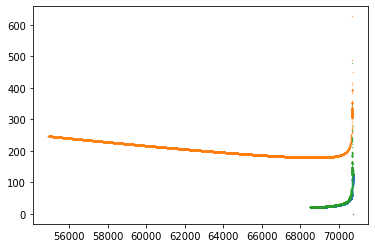

In [82]:
for i in range(N):
    plt.scatter(np.sqrt(X[:,i]**2+Y[:,i]**2),np.sqrt(Vx[:,i]**2+Vy[:,i]**2), s=0.1)

In [ ]:
ani = animation.FuncAnimation(fig, animate, save_count = 100)
#ani = animation.FuncAnimation(fig, animate)
dpi = 200
writer = animation.writers['ffmpeg'](fps = 20)
# file_name = str(time.gmtime()[0:5]) + '.GIF'
file_name = 'output.mp4'
# ani.save( file_name ,dpi=dpi, writer = 'imagemagick')
ani.save( file_name, dpi=dpi, writer = writer)
file_name

Text(0.5, 1.0, '3 +0.5 defects, a=10.0')

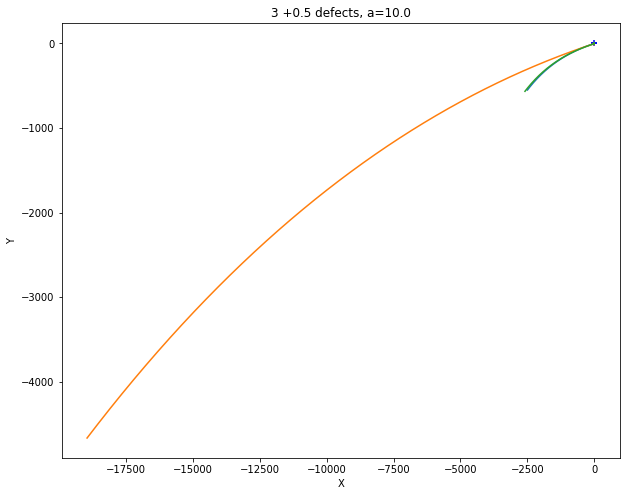

In [84]:
end = -1
plt.figure(figsize=(10,8))
for i in range(len(def_loc[:,0])):
    if def_sigma[i]>0:
        plt.scatter(def_loc[i,0]-bias, def_loc[i,1]-bias, marker='+', c='b')
    if def_sigma[i]<0:
        plt.scatter(def_loc[i,0]-bias, def_loc[i,1]-bias, marker='_', c='b')
plt.plot(X[:end]-bias, Y[:end]-bias)
plt.xlabel('X')
plt.ylabel('Y')
plt.title(str(N)+' +0.5 defects, a='+str(alpha))

In [75]:
# X_, Y_ = get_fixedpoint((def_loc, def_sigma, l, a, alpha, 0.02))
pert=1e-10
perturned_loc = def_loc+np.ones(def_loc.shape)*np.random.choice([pert, -pert])
X1, Y1, Vx1, Vy1, t = get_trajectory((perturned_loc, def_sigma, L, a, alpha, tMax, 0.01))

Text(0.5, 1.0, '3 +0.5 defects, a=0.02, perturbed 6.111804395914078e-10')

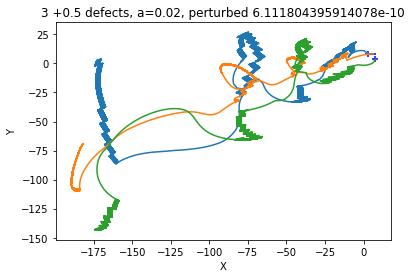

In [76]:
for i in range(len(def_loc[:,0])):
    if def_sigma[i]>0:
        plt.scatter(perturned_loc[i,0]-bias, perturned_loc[i,1]-bias, marker='+', c='b')
    if def_sigma[i]<0:
        plt.scatter(perturned_loc[i,0]-bias, perturned_loc[i,1]-bias, marker='_', c='b')
plt.plot(X1-bias, Y1-bias)
plt.xlabel('X')
plt.ylabel('Y')
plt.title(str(N)+' +0.5 defects, a=0.02, perturbed '+str(np.sum(np.abs(perturned_loc-def_loc))))

Text(0, 0.5, 'X')

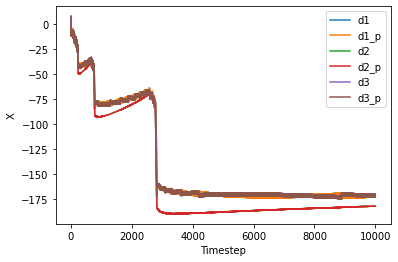

In [77]:
end = -1
for i in range(def_loc.shape[0]):
    plt.plot(X[:end,i]-bias, label='d'+str(i+1))
    plt.plot(X1[:end,i]-bias, label='d'+str(i+1)+'_p')
plt.legend()
plt.xlabel('Timestep')
plt.ylabel('X')

Text(0, 0.5, 'L2 Dislocation')

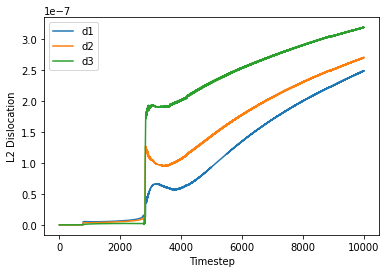

In [78]:
end = -1
for i in range(def_loc.shape[0]):
    d1 = (X[:end,i] - X1[:end,i])**2
    d2 = (Y[:end,i] - Y1[:end,i])**2
    d = np.sqrt(d1+d2)
    plt.plot(d, label='d'+str(i+1))
plt.legend()
plt.xlabel('Timestep')
plt.ylabel('L2 Dislocation')

Text(0, 0.5, 'L2 Dislocation Log')

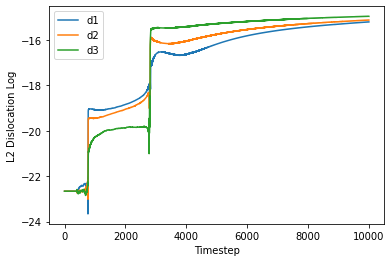

In [79]:
for i in range(def_loc.shape[0]):
    d1 = (X[:,i] - X1[:,i])**2
    d2 = (Y[:,i] - Y1[:,i])**2
    d = np.sqrt(d1+d2)
    plt.plot(np.log(d[1:]), label='d'+str(i+1))
plt.legend()
plt.xlabel('Timestep')
plt.ylabel('L2 Dislocation Log')

-0.22660814760822742


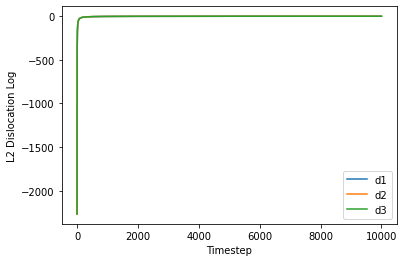

In [25]:
for i in range(def_loc.shape[0]):
    d1 = (X[:,i] - X1[:,i])**2
    d2 = (Y[:,i] - Y1[:,i])**2
    d = np.multiply(np.log(np.sqrt(d1+d2)[:1]), 1.0/np.arange(start=0.01,stop=tMax+0.01,step=0.01))
    plt.plot(d, label='d'+str(i+1))
plt.legend()
plt.xlabel('Timestep')
plt.ylabel('L2 Dislocation Log')
# plt.xlim([-10, 50])
print(np.max(d))

In [ ]:
l_exp = np.zeros(X.shape[0])
ratio = np.zeros(X.shape[0])
disloc = np.zeros(X.shape[0])

disloc = np.abs(X-X1)
ratio = disloc/disloc[0,:]
l_exp = np.log(ratio)/t[:,None]

end = -1
plt.plot(l_exp[-1-100:end,0])
plt.axhline(y=0, color ="red", linestyle ="--")
plt.xlabel('Time')
# plt.ylabel('Lyapunov Exponent')
# plt.plot(t, np.exp(t))

In [58]:
res = np.load('results/1e9/disloc_2.npy')
res = res.reshape(res.shape[0]*res.shape[1], res.shape[2])

start = 1
end = 100000

res = np.log(res)
mean = np.mean(res[:,start:end],axis=0)
std = np.std(res[:,start:end],axis=0)/np.sqrt(res.shape[0])

Text(0, 0.5, 'Average Log of displacements')

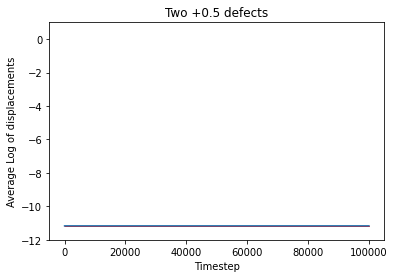

In [59]:

plt.plot(mean)
plt.fill_between(x=np.arange(start=start, stop=end), y1=mean-std/2.0, y2=mean+std/2.0, color='red')

plt.ylim([-12,1])

plt.title('Two +0.5 defects')
plt.xlabel('Timestep')
plt.ylabel('Average Log of displacements')

In [65]:
res = np.load('results/1e9/disloc_3.npy')
res = res.reshape(res.shape[0]*res.shape[1], res.shape[2])

start = 1
end = 100000

res = np.log(res)
mean = np.mean(res[:,start:end],axis=0)
std = np.std(res[:,start:end],axis=0)/np.sqrt(res.shape[0])

Text(0, 0.5, 'Average Log of displacements')

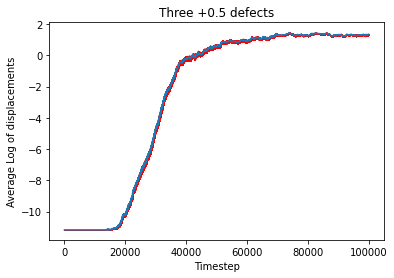

In [66]:

plt.plot(mean)
plt.fill_between(x=np.arange(start=start, stop=end), y1=mean-std/2.0, y2=mean+std/2.0, color='red')

# plt.ylim([-12,1])

plt.title('Three +0.5 defects')
plt.xlabel('Timestep')
plt.ylabel('Average Log of displacements')

In [9]:
res = np.load('results/1e9/disloc_4.npy')
res = res.reshape(res.shape[0]*res.shape[1], res.shape[2])

start = 1
end = 100000

res = np.log(res)
mean = np.mean(res[:,start:end],axis=0)
std = np.std(res[:,start:end],axis=0)/np.sqrt(res.shape[0])

Text(0, 0.5, 'Average Log of displacements')

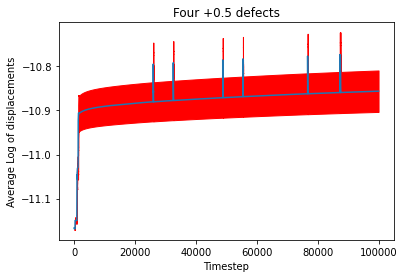

In [10]:
plt.plot(mean)
plt.fill_between(x=np.arange(start=start, stop=end), y1=mean-std/2.0, y2=mean+std/2.0, color='red')

plt.ylim([-12,1])

plt.title('Four +0.5 defects')
plt.xlabel('Timestep')
plt.ylabel('Average Log of displacements')

In [11]:
res = np.load('results/1e9/disloc_5.npy')
res = res.reshape(res.shape[0]*res.shape[1], res.shape[2])

start = 1
end = 100000

res = np.log(res)
mean = np.mean(res[:,start:end],axis=0)
std = np.std(res[:,start:end],axis=0)/np.sqrt(res.shape[0])

Text(0, 0.5, 'Average Log of displacements')

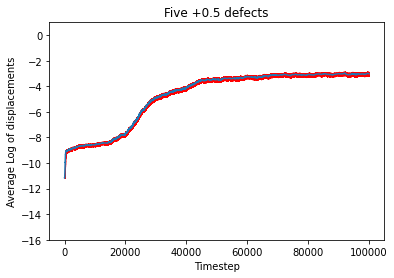

In [13]:
plt.plot(mean)
plt.fill_between(x=np.arange(start=start, stop=end), y1=mean-std/2.0, y2=mean+std/2.0, color='red')

plt.ylim([-16,1])

plt.title('Five +0.5 defects')
plt.xlabel('Timestep')
plt.ylabel('Average Log of displacements')

Text(0, 0.5, 'I (A)')

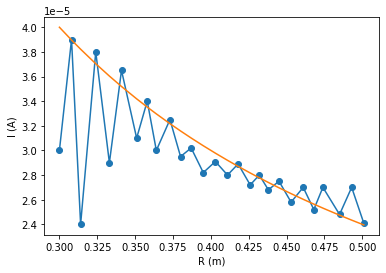

In [78]:
R = np.array([30,30.8,31.4,32.4,33.3,34.1,35.1,35.8,36.4,37.3,38,38.7,39.5,40.3,41.1,41.8,42.6,43.2,43.8,44.5,45.3,46.1,46.8,47.4,48.5,49.3,50.1])*1e-2
I = np.array([30,39,24,38,29,36.5,31,34,30,32.5,29.5,30.2,28.2,29.1,28,28.9,27.2,28,26.8,27.5,25.8,27,25.2,27,24.8,27,24.1])*1e-6
plt.plot(R,I, '-o')
plt.plot(R,0.000012*1/R)
plt.xlabel('R (m)')
plt.ylabel('I (A)')

In [87]:
np.mean(R[1:] - R[:-1])*1e2

0.7730769230769231